In [1]:
# Libraries used for this analysis
!pip install folium # installs folium
import pandas as pd # imports pandas
import numpy as np # imports numpy
import matplotlib.pyplot as plt # to plot graphs
from matplotlib.pyplot import figure # to modify size of figures
import matplotlib.patches as mpatches # for 
import datetime as dt # for datetime objects
import folium # to create maps
from branca.colormap import LinearColormap # to create color maps
import seaborn as sns # imports seaborn
import warnings
warnings.filterwarnings("ignore")

In [2]:
# donations from Alabama to California         # parse in dates as datatimes
a_c = pd.read_csv('alabama_to_california.csv', parse_dates=['contribution_receipt_date']) 
# take a sample of each dataset since total dataset is so large
sample1 = a_c.sample(frac=0.10, random_state=99)

# donations from Colorado to Kentucky
c_k = pd.read_csv('colorado_to_kentucky.csv', parse_dates=['contribution_receipt_date'])
sample2 = c_k.sample(frac=0.10, random_state=99)

# donations from Louisiana to New Hampshire
l_n = pd.read_csv('louisiana_to_newhampshire.csv', parse_dates=['contribution_receipt_date'])
sample3 = l_n.sample(frac=0.10, random_state=99)

# donations from New Jersey to South Dakota
n_s = pd.read_csv('newjersey_to_southdakota.csv', parse_dates=['contribution_receipt_date'])
sample4 = n_s.sample(frac=0.10, random_state=99)

# donations from Tennessee to Wyoming
t_q = pd.read_csv('tennessee_to_wyoming.csv', parse_dates=['contribution_receipt_date'])
sample5 = t_q.sample(frac=0.10, random_state=99)

In [3]:
# combine all of the sampled datasets into one
d1 = sample1.append(sample2, ignore_index=True)
d2 = d1.append(sample3, ignore_index=True)
d3 = d2.append(sample4, ignore_index=True)
data = d3.append(sample5, ignore_index=True)

In [4]:
# final result, 10% of the total dataset of all donations made in the first 3 Quarters from donors exceeding $200
data.head()

,committee_id,committee_name,report_year,report_type,image_number,line_number,transaction_id,file_number,committee_name.1,entity_type,...,filing_form,link_id,is_individual,memo_text,two_year_transaction_period,schedule_type,increased_limit,sub_id,pdf_url,line_number_label
0,C00580100,"DONALD J. TRUMP FOR PRESIDENT, INC.",2019,Q3,201911139165422531,18,SA18.126452,1362579,NaN,IND,...,F3P,4111420191678669704,t,NaN,2020,SA,NaN,4111620191678916175,http://docquery.fec.gov/cgi-bin/fecimg/?201911...,Transfers From Other Authorized Committees
1,C00580100,"DONALD J. TRUMP FOR PRESIDENT, INC.",2019,Q3,201911139165454680,18,SA18.308663,1362579,NaN,IND,...,F3P,4111420191678669704,t,NaN,2020,SA,NaN,4111620191679012623,http://docquery.fec.gov/cgi-bin/fecimg/?201911...,Transfers From Other Authorized Committees
2,C00693234,"WARREN FOR PRESIDENT, INC.",2019,Q3,201910159164346967,17A,4152547,1358497,NaN,IND,...,F3P,4101620191674360744,t,* EARMARKED CONTRIBUTION: SEE BELOW,2020,SA,NaN,4110520191678135063,http://docquery.fec.gov/cgi-bin/fecimg/?201910...,Contributions From Individuals/Persons Other T...
3,C00696948,BERNIE 2020,2019,Q3,201910159164166375,17A,12906650,1357929,NaN,IND,...,F3P,4101520191674204879,t,* EARMARKED CONTRIBUTION: SEE BELOW,2020,SA,NaN,4103120191676815904,http://docquery.fec.gov/cgi-bin/fecimg/?201910...,Contributions From Individuals/Persons Other T...
4,C00697441,"PETE FOR AMERICA, INC.",2019,Q2,201907159151265686,17A,867258,1341083,NaN,IND,...,F3P,4071620191659583353,t,* EARMARKED CONTRIBUTION: SEE BELOW,2020,SA,NaN,4072320191661016349,http://docquery.fec.gov/cgi-bin/fecimg/?201907...,Contributions From Individuals/Persons Other T...


In [5]:
# dataset to match states with latitude and longitude
states_loc = pd.read_csv('statelatlong.csv')

# dataset with state populations
states_pop = pd.read_csv('State Populations.csv')

# rename column in population data set to make it cleaner for final states dataset
states_pop.rename(columns={'State': 'City'}, inplace=True)

# merge the datasets together into one
states = pd.merge(states_loc, states_pop, on='City', how='inner')

# final states dataset used
states.head()

,State,Latitude,Longitude,City,2018 Population
0,AL,32.601011,-86.680736,Alabama,4888949
1,AK,61.302501,-158.775020,Alaska,738068
2,AZ,34.168219,-111.930907,Arizona,7123898
3,AR,34.751928,-92.131378,Arkansas,3020327
4,CA,37.271875,-119.270415,California,39776830


In [6]:
# dataset to convert zip codes to counties 
counties = pd.read_csv('zip_county_fips_2018_03.csv')

# converts zip column to int values
counties.zip = counties['zip'].astype('int')

# final counties dataset used for analysis
counties.head()

,zip,stcountyfp,city,state,countyname,classfp
0,36091,1001,Verbena,AL,Autauga County,H1
1,36758,1001,Plantersville,AL,Autauga County,H1
2,36006,1001,Billingsley,AL,Autauga County,H1
3,36067,1001,Prattville,AL,Autauga County,H1
4,36701,1001,Selma,AL,Autauga County,H1


In [7]:
# dataset used to classify occupations based on SOC
occupations = pd.read_csv('https://raw.githubusercontent.com/dawaldron/data-visualizations/master/actblue_data_2020/titleocc_xw_final.csv')

# drop unnecessary columns for this analysis
occupations.drop(columns = ['freq', 'source', 'onetcode', 'onettitle'], inplace = True)

# final occupations dataset used
occupations.head()

,soccode,soctitle,occupation
0,11-1011,Chief executives,CEO
1,11-1011,Chief executives,EXECUTIVE DIRECTOR
2,11-1011,Chief executives,PRESIDENT
3,11-1011,Chief executives,VP
4,11-1011,Chief executives,VICE PRESIDENT


In [8]:
# data set used to group occupations into SOC groupings
occ_agg = pd.read_csv('https://raw.githubusercontent.com/dawaldron/data-visualizations/master/actblue_data_2020/occgrpnm.csv')

# Only need the first two numbers of the SOC number to match subclasses of occupations
occ_agg['occgrpcd'] = occ_agg['occgrpcd'].str[:2]

# final occupational grouping dataset used
occ_agg.head()

,occgrpcd,occgrpnm2,N
0,11,Management,1
1,13,Business and financial,1
2,15,Computer and mathematical,1
3,17,Architecture and engineering,1
4,19,"Life, physical, social science",1


In [9]:
# take the needed columns from the original data that we need for this analysis
data_clean = data[['committee_id', 'report_type', 'contributor_name', 
                   'contributor_state', 'contributor_zip', 'contributor_occupation', 'contribution_receipt_date', 
                       'contribution_receipt_amount', 'contributor_aggregate_ytd']]

# convert some columns to numerical values
data_clean['contribution_receipt_amount'] = pd.to_numeric(data_clean['contribution_receipt_amount'])
data_clean['contributor_aggregate_ytd'] = pd.to_numeric(data_clean['contributor_aggregate_ytd'])

# clean zip code data to only having the 6 digits associated with each zip code
data_clean['contributor_zip'] = data_clean['contributor_zip'].astype(str).str[:5]

# drop any donations that exceeded the limit as well as drop an recended donations
data_clean = data_clean.drop(data_clean[(data_clean['contribution_receipt_amount'] <= 0) & 
                                        (data_clean['contribution_receipt_amount'] > 2800)].index)

In [10]:
# to create recipient name column
names = []
for index, row in data_clean.iterrows():
    if row['committee_id'] == 'C00696948': # Sander's Presidential Committee
        names.append('Sanders')
    elif row['committee_id'] == 'C00580100': # Trump's Presidential Committee
        names.append('Trump')
    elif row['committee_id'] == 'C00703975': # Biden's Presidential Committee
        names.append('Biden')
    elif row['committee_id'] == 'C00693234': # Warren's Presidential Committee
        names.append('Warren')
    elif row['committee_id'] == 'C00697441': # Buttigieg's Presidential Committee
        names.append('Buttigieg')
    elif row['committee_id'] == 'C00696419': # Klobuchar's Presidential Committee
        names.append('Klobuchar')
    else: 
        print('error')
        
# insert new column into the data_clean dataset
data_clean.insert(0, "recipient_name", names, True)

# drop committee_id column since we now have recipient name
data_clean.drop(columns = 'committee_id', inplace = True)

# Add new column to represent party id, True: Rep, False: Dem
data_clean['Party'] = data_clean['recipient_name'] == 'Trump'

In [11]:
# final dataset used in analysis
data_clean.head()

,recipient_name,report_type,contributor_name,contributor_state,contributor_zip,contributor_occupation,contribution_receipt_date,contribution_receipt_amount,contributor_aggregate_ytd,Party
0,Trump,Q3,"ELF, SHARI",CA,92256,ARTIST,2019-09-23,7.5,169.15,True
1,Trump,Q3,"NELSON, MARGIE B.",CA,91701,RETIRED,2019-09-04,82.5,240.00,True
2,Warren,Q3,"LUCE, MARK",AZ,85715,PHYSICIAN,2019-09-11,50.0,250.00,False
3,Sanders,Q3,"WEINER, MATTHEW",CA,91436,WRITER,2019-09-12,250.0,500.00,False
4,Buttigieg,Q2,"SHEEHAN, LINDA",CA,94061,LAWYER,2019-05-29,500.0,500.00,False


In [12]:
# function that creates a bar plot given a dataset, the column being meausured, the plot, and color of the bars
def bar_plot_func(data, column, p, color):
    # calculate total number of donations in given dataset
    total_donations = data.shape[0]
    
    # to make the plot bigger
    figure(num=None, figsize=(20, 10), dpi=80, facecolor='w', edgecolor='k')

    # calculate the number of donations in each of the column's values. In this case either Quarters or Candidates
    donos = pd.DataFrame(data[column].value_counts()).sort_index()
    
    # calculate percentages of total donations
    donos['% of Total Donations'] = (donos[column].astype(float) / total_donations) * 100

    # create bar plot
    p.bar(donos.index, donos['% of Total Donations'], align='center', alpha=0.5, 
           color= color)
    
    # show the percentages on the bar plot
    for i, v in enumerate(donos['% of Total Donations']):
        p.text(i - .07, v + 1, "{0:.2f}".format(v) + "%", color='black', fontweight='bold')
        
    return p

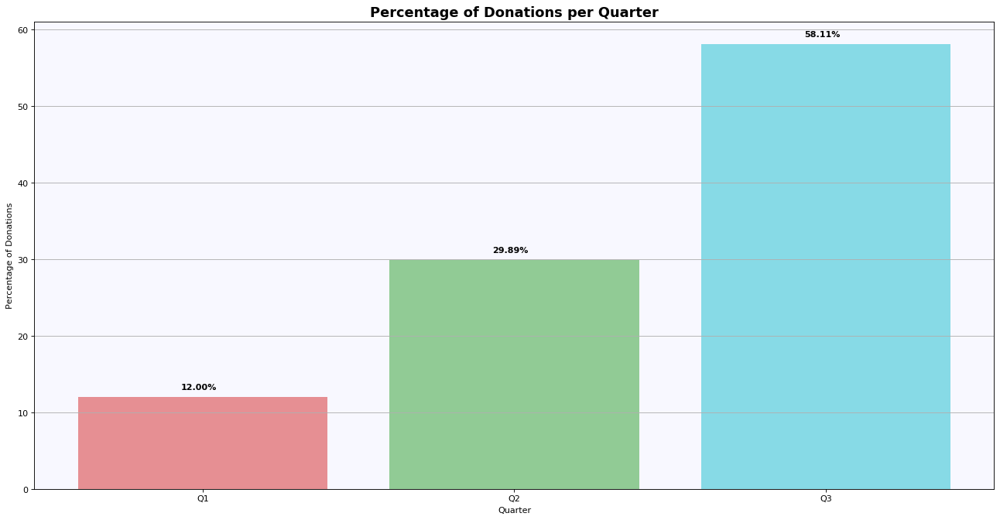

In [13]:
# produce bar plot for percentage of donations per quarter
quater_graph = bar_plot_func(data_clean, 'report_type', plt, ['tab:red', 'tab:green', 'tab:cyan'])

# to change the labels, add grid, background color, title
plt.xlabel('Quarter')
plt.ylabel('Percentage of Donations')
plt.title('Percentage of Donations per Quarter', fontsize=16, fontweight='bold')
ax = plt.gca()
ax.set_facecolor('ghostwhite')
plt.axes().yaxis.grid()

plt.show()

In [14]:
# function that creates a scatter plot based on dataset, plot, figure, and color
def count_func(data, p, figure, color):
    # calculates total donations in dataset
    total_donations = data.shape[0]
    
    # determines the size of the plot
    figure
    
    # counts the number of donations recieved on that date
    count = pd.DataFrame(data['contribution_receipt_date'].value_counts()).sort_index()
    
    # creates new column to store dates as integers from 0 to 280
    count['Date'] = count.index.map(dt.datetime.toordinal) - 737060

    # x-value is between 0 and 280
    x = count['Date']
    
    # y-value is the percentage of donations recieved on that day
    y = (count['contribution_receipt_date'] / total_donations) * 100

    # to create curved fitted line for the data
    poly = np.polyfit(x, y, 2)
    f = np.poly1d(poly)
    x_new = np.linspace(x[0], x[-1], 50)
    y_new = f(x_new)
    
    # add scatter plot to the given plot
    p.scatter(x, y, c = color)
    
    # add fitted line to given plot
    p.plot(x_new, y_new, c = 'tab:orange')
    
    # to match x index with the appropriate month
    index = [0, 31, 59, 90, 120, 151, 181, 212, 243, 273]
    months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct']
    
    # to add labels, background color, x, y limits, grid
    p.set_xticks(index)
    p.set_xticklabels(months)
    p.set_xlabel('Time')
    p.set_ylabel('Percentage of Donations')
    p.set_xlim([-10, 280])
    p.set_ylim(bottom=0)
    p.set_facecolor('ghostwhite')
    p.grid()
    
    return p

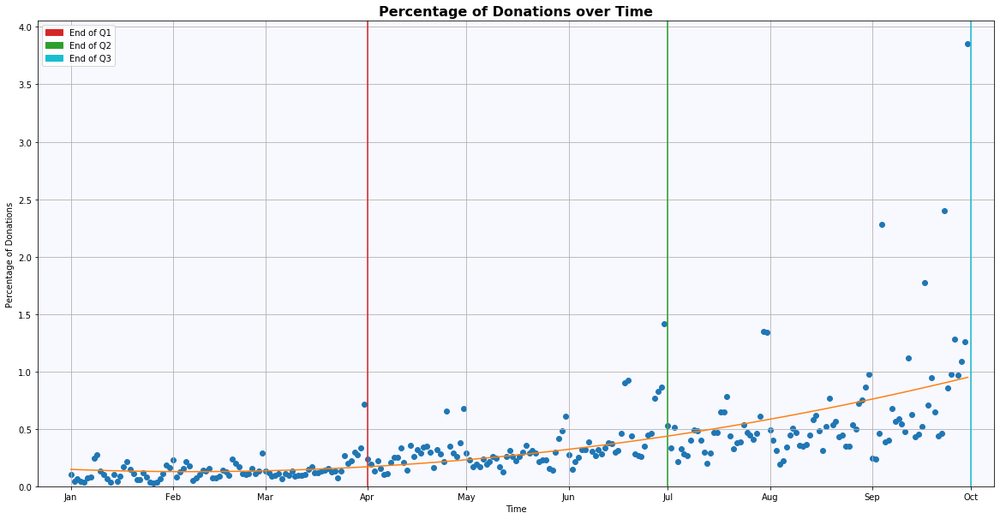

In [15]:
# to create a subplot to show the plot
fig, ax = plt.subplots(1, 1)

# to make the plot bigger
fig.set_figheight(10)
fig.set_figwidth(20)

# adds lines marking where the Quarters end
plt.axvline(x=90, linestyle = '-', color = 'tab:red')
plt.axvline(x=181, linestyle = '-', color = 'tab:green')
plt.axvline(x=273, linestyle = '-', color = 'tab:cyan')

# call to function to produce scatter plot
count_func(data_clean, ax, fig, 'tab:blue')

# add appropriate title
ax.set_title('Percentage of Donations over Time', fontsize=16, fontweight='bold')

# add patches used for the legend of the graph
Q1 = mpatches.Patch(color='tab:red', label='End of Q1')
Q2 = mpatches.Patch(color='tab:green', label='End of Q2')
Q3 = mpatches.Patch(color='tab:cyan', label='End of Q3')

# add the legend to the graph
plt.legend(handles=[Q1, Q2, Q3])

fig.show()

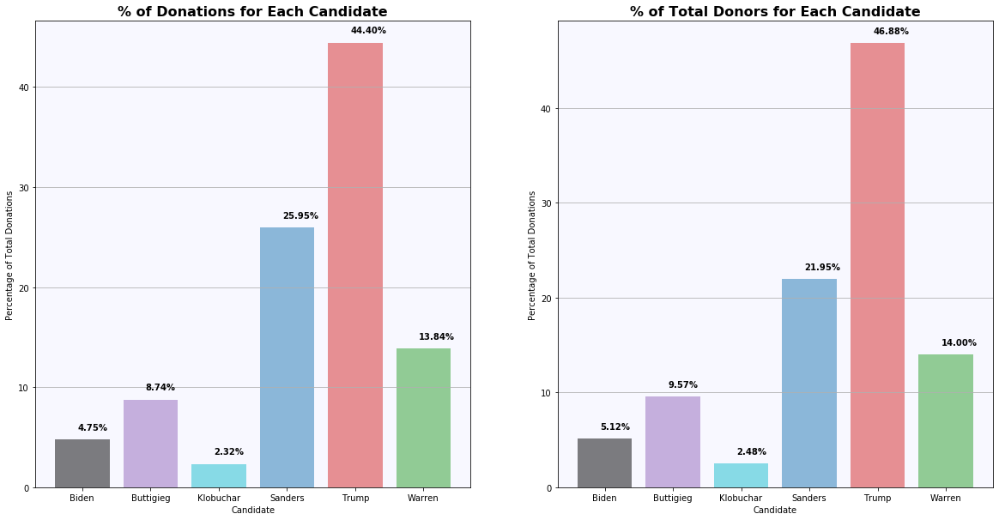

<Figure size 1600x800 with 0 Axes>

<Figure size 1600x800 with 0 Axes>

In [16]:
# creates two subplots
fig, ax = plt.subplots(1, 2)

# makes entire figure larger
fig.set_figheight(10)
fig.set_figwidth(20)

# the two different titles for the two graphs
title = ['% of Donations for Each Candidate', '% of Total Donors for Each Candidate']

# the colors used to represent each candidate
color = ['black', 'tab:purple', 'tab:cyan', 'tab:blue', 'tab:red', 'tab:green']

# add grid, labels, subtitles, background color
for i in range(len(ax)):
    ax[i].grid(axis = 'y')
    ax[i].set_xlabel('Candidate')
    ax[i].set_ylabel('Percentage of Total Donations')
    ax[i].set_title(title[i],fontsize=16, fontweight='bold')
    ax[i].set_facecolor('ghostwhite')

# adds first bar plot to the first subplot
bar_plot_func(data_clean, 'recipient_name', ax[0], color)

# create a dataset that has the number of donors
donors = data_clean.drop_duplicates(subset=['contributor_name', 'recipient_name'])

# adds second bar plot to the second subplot
bar_plot_func(donors, 'recipient_name', ax[1], color)

fig.show()

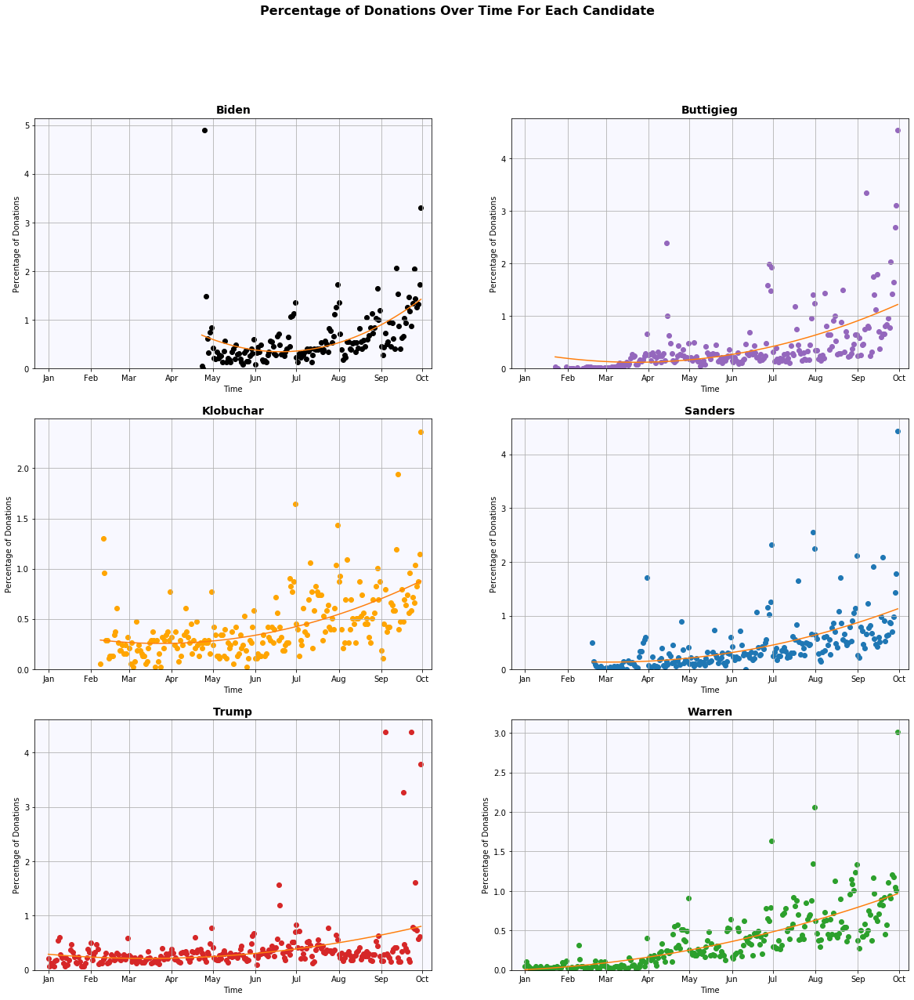

In [17]:
# creates a figure with 3 by 2 subplots, one plot for each candidate
fig, ax = plt.subplots(3, 2)

# make the figure larger
fig.set_figheight(20)
fig.set_figwidth(20)

# the different colors for the scatter points in each graph
color = ['black', 'tab:purple', 'orange', 'tab:blue', 'tab:red', 'tab:green']

# the names for each of candidates represented in each subplot
name = ['Biden', 'Buttigieg', 'Klobuchar', 'Sanders', 'Trump', 'Warren']

# adds title and scatter plots to each subplot
w = 0
for i in range(len(ax)):
    for j in range(len(ax[i])):
        ax[i, j].set_title(name[w], fontsize=14, fontweight='bold')
        count_func(data_clean[data_clean['recipient_name'] == name[w]], ax[i, j], fig, color[w])
        w += 1

# addes main title to the main figure
fig.suptitle('Percentage of Donations Over Time For Each Candidate', fontsize=16, fontweight='bold')

fig.show()

In [18]:
# function that adds a choropleth map to the given map based on given data, color, and name of candidate
def state_map_func(data, m, color, name):
    # counts number of donations in each state
    donations_state = pd.DataFrame(data['contributor_state'].value_counts()).sort_index()
    
    # adds column of the state each row represents
    donations_state['donations_state'] = donations_state.index
    
    # merges this dataset with the states dataset that we read in
    donations_state = pd.merge(donations_state, states, left_on = 'donations_state', right_on = 'State', how='inner')
    
    # calculates the donations per capita in each state 
    donations_state['%'] = ((donations_state['contributor_state'].astype(int) * 10) / 
                            donations_state['2018 Population']) * 100 

    # used to create folium choropleth map that is added to the given map
    folium.Choropleth(
            geo_data= 'us-states.json',             # json file that shows the regions of each state
            name= name,                             # name of candidate added to the layer control 
            data=donations_state,                   # dataset we are pulling from
            columns=['donations_state', '%'],       # the state and donations per capita in that state
            key_on = 'feature.id',                  # the id value used to match info from json file
            fill_color= color,                      # the color used for the choropleth
            fill_opacity=0.7,                       # changes the filled in color's opacity
            line_opacity=0.2,                       # changes the line's opacity
            legend_name='% of Donations for '       # add title for each legend
                + name + ' Per Capita',             
            overlay=False,                          # makes it so that user cannot view two map's at once
            show=False                              # map isn't shown when opened
        ).add_to(m)
    
    return m

In [19]:
# create new folium map of the United States
s_m = folium.Map(location=[37, -102], zoom_start=4)

# different Folium colors to represent each candidate
folium_colors = ['Greys', 'Purples', 'Oranges', 'Blues', 'Reds', 'Greens']

# adds choropleth map to s_m for each candidate
for i in range(6):
    s_m = state_map_func(donors[donors['recipient_name'] == name[i]], s_m, folium_colors[i], name[i])

# adds ability to switch to different maps
folium.LayerControl().add_to(s_m)

s_m

In [20]:
# function that produces choropleth map for all the candidates on the county level
def county_map_func(best, m, map1):
    # colors used to represent each candidate
    color = ['black', 'purple', 'orange', 'blue', 'red', 'green']
    
    # a list to add all of the color scales to
    color_scale = []
    for i in range(len(color)):
        color_scale.append(LinearColormap(['white', color[i]], vmin = min(best['%']), vmax = max(best['%'])))

    # function that gets the right color for the choropleth map given county value from json
    def get_color(feature):
        # value is the row with the county from feature
        value = best.loc[best['county'] == feature['properties']['NAME']]
        
        # if no row for given county, return white
        if value is None:
            return '#ffffff'
        
        # if more than one County row, return white
        elif len(value) != 1:
            return '#ffffff'
        
        # used for the first county map, determines the color used for choropleth
        if map1:
            if value['name'].item() == 'Biden':                    # Biden
                return color_scale[0](value['%'].item())           
            elif value['name'].item() == 'Buttigieg':              # Buttigieg
                return color_scale[1](value['%'].item())
            elif value['name'].item() == 'Klobuchar':              # Klobuchar
                return color_scale[2](value['%'].item())
            elif value['name'].item() == 'Sanders':                # Sanders
                return color_scale[3](value['%'].item())
            elif value['name'].item() == 'Warren':                 # Warren
                return color_scale[5](value['%'].item())
            else:                   
                return '#ffffff'
        # for the second map
        else:
            if value['name'].item() == 'Trump':
                if value['%'].item() > 50.00:
                    return color_scale[4](value['%'].item())       # Trump higher percentage, use his color 
                else:
                    return color_scale[3](100 - value['%'].item()) # Dems higher percentage, use blue
            else: 
                return color_scale[3](100)                         # No Trump, means Dems 100%
    
    # creates folium map
    folium.GeoJson(
        data = 'cb_2015_us_county_5m.json',                        # json that has county regions
        style_function = lambda feature: {                         # determines the color to add
        'fillColor': get_color(feature),                           # calls get_color function
        'fillOpacity': 0.7,                                        # changes opacity of filled areas
        'color' : 'black',                                         # color of lines
        'weight' : 0,                                              # lines not to be shown for counties
        },
        name = 'map', overlay=False).add_to(m)    
    return m

In [21]:
# function that converts given data to be used for county level maps
def convert_for_map(data):
    # counts donors per zip code
    donations_county = pd.DataFrame(data.groupby('contributor_zip')['recipient_name'].value_counts()).sort_index()
    donations_county.rename(columns={'recipient_name':'freq'}, inplace = True)
    donations_county = donations_county.reset_index()
    
    # converts zip column in donations_county to type float
    donations_county['contributor_zip'] = donations_county['contributor_zip'].astype('float')
    
    # merges counties with donations_county
    donations_county = pd.merge(counties, donations_county, left_on = 'zip', right_on = 'contributor_zip', 
                                how='inner')

    # calculates number of donations in each county
    sums = pd.DataFrame(donations_county.groupby('countyname')['freq'].sum())
    sums = sums.reset_index()
    sums.rename(columns= {'freq':'total_county', 'countyname':'county'}, inplace = True)

    # calculates number of donations in each county for each candidate
    sums_candidates = pd.DataFrame(donations_county.groupby(['countyname', 'recipient_name'])['freq'].sum())
    sums_candidates

    # addes county and name colomns to dataset
    county = []
    name = []
    for index, row in sums_candidates.iterrows():
        county.append(index[0])
        name.append(index[1])

    sums_candidates['name'] = name
    sums_candidates['county'] = county

    # combines datasets
    sums_both = pd.merge(sums_candidates, sums, on='county', how='inner')

    # calculates % of donations in county for each candidate
    sums_both['%'] = sums_both['freq'] / sums_both['total_county']

    # finds indices with the highest percentage of donations for each county
    idx = sums_both.groupby('county')['%'].transform(max) == sums_both['%']
    
    # drops other rows that arent included in idx
    best = sums_both[idx]
    
    # takes out County substring for county names in county column
    best['county'] = best['county'].map(lambda x: x.replace(' County', ''))
    
    # multiply the % by 100
    best['%'] = best['%'] * 100
    
    # take out needed columns for maps
    map_dict = pd.DataFrame(best[['county', 'name', '%']].copy())
    
    return map_dict

In [22]:
# Find rows that are for Trump
ind = donors[donors['recipient_name'] == 'Trump'].index

# Drops those rows to only have Dem candidates left
donors_minus_trump = donors.drop(ind)

# Convert dataset to a dataset we can use for map
donors_minus_trump_map = convert_for_map(donors_minus_trump)

# final dataset used for first county level map
donors_minus_trump_map.head()

,county,name,%
1,Abbeville,Klobuchar,50.000000
3,Acadia Parish,Buttigieg,50.000000
4,Acadia Parish,Sanders,50.000000
5,Accomack,Sanders,66.666667
10,Ada,Sanders,50.000000


In [23]:
# Creates new folium map of United States
c_m1 = folium.Map(location=[37, -102], zoom_start=4)  

# Adds Choropleth map
map1 = county_map_func(donors_minus_trump_map, c_m1, True)

map1

In [24]:
# get clean dataset
data_plus_trump = data_clean 

# Calculate new donors dataset based on party
donors_party = data_plus_trump.drop_duplicates(subset=['contributor_name', 'Party'])

# convert dataset to a dataset that can be used for the county level map
donors_map = convert_for_map(donors)

# final dataset used for second county level map
donors_map.head()

,county,name,%
2,Abbeville,Trump,76.470588
6,Acadia Parish,Trump,81.818182
8,Accomack,Trump,57.142857
14,Ada,Trump,59.203980
18,Adair,Trump,58.823529


In [25]:
# Create new folium map of the United States
c_m2 = folium.Map(location=[37, -102], zoom_start=4) 

# Add choropleth map
map2 = county_map_func(donors_map, c_m2, False)

map2

In [26]:
# function that converts given dataset into a dataset that can be used for the heatmap
def occ_convert_func(data, name):
    # merges given data with the occupations dataset
    occ = pd.merge(data, occupations, left_on = 'contributor_occupation', right_on = 'occupation', how = 'inner')
    
    # only need the first 2 digits of the soc code to match
    occ['soccode_new'] = occ['soccode'].str[:2]

    # merge occ dataset with the SOC groups
    occ_main = pd.merge(occ, occ_agg, left_on = 'soccode_new', right_on = 'occgrpcd', how = 'inner')
    
    # drop unecessary columns
    occ_main.drop(columns = ['N', 'occgrpcd', 'soccode_new', 'occupation', 'soccode', 'soctitle'], inplace = True)
    
    # counts the number of occurrences of that group
    count_title = pd.DataFrame(occ_main['occgrpnm2'].value_counts()).reset_index()
    
    # count the number of occurrences for each candidate for each occupation
    count = pd.DataFrame(occ_main.groupby(['occgrpnm2'])[name].value_counts())
    
    # rename name columns to count_per_person
    count.rename(columns={name:'counts_per_person'}, inplace = True)
    count = count.reset_index()

    # merges two data sets together
    count_total = pd.merge(count, count_title, left_on = 'occgrpnm2',
                          right_on = 'index', how = 'inner')
    
    # renames certian columns
    count_total.rename(columns={'index': 'Occ Name', 'occgrpnm2_y': 'total'}, inplace = True)
    
    # drops uneccessary column 
    count_total.drop(columns = 'occgrpnm2_x', inplace = True)

    # calculate percentage of donors to each candidate based on occupation
    count_total['%'] = count_total['counts_per_person'] / count_total['total']
    
    return count_total

  recipient_name  counts_per_person                Occ Name  total         %
0        Sanders                544  Administrative support    881  0.617480
1         Warren                169  Administrative support    881  0.191827
2      Buttigieg                106  Administrative support    881  0.120318
3          Biden                 42  Administrative support    881  0.047673
4      Klobuchar                 20  Administrative support    881  0.022701
   Party  counts_per_person                      Occ Name  total         %
0  False                858        Administrative support   1567  0.547543
1   True                709        Administrative support   1567  0.452457
2  False               1098  Architecture and engineering   1819  0.603628
3   True                721  Architecture and engineering   1819  0.396372
4  False               1935        Arts and entertainment   2209  0.875962


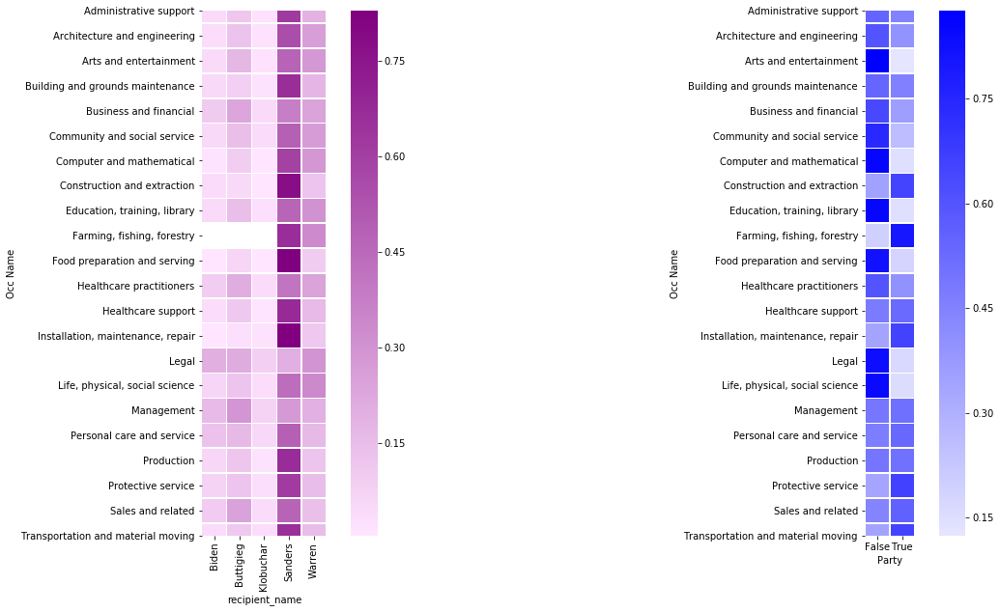

In [27]:
# create two subplots for each heatmap
fig, ax = plt.subplots(1, 2)

# make the figure bigger
fig.set_figheight(10)
fig.set_figwidth(20)

# color for the first heatmap
color1 = sns.light_palette("purple", as_cmap=True)

# color for the second heatmap
color2 = sns.light_palette("blue", as_cmap=True)

# converts given data to be used for first heatmap
heat_1 = occ_convert_func(donors_minus_trump, 'recipient_name')
print(heat_1.head())

# converts given data to be used for second heatmap
heat_2 = occ_convert_func(donors_party, 'Party')
print(heat_2.head())

# creates pivot for first heatmap
pivot_without_trump = heat_1.pivot(index='Occ Name', columns='recipient_name', values='%')

# creates pivot for second heatmap
pivot_with_trump = heat_2.pivot(index='Occ Name', columns='Party', values='%')

# heatmap 1
sns.heatmap(pivot_without_trump, cmap=color1, square=True, linewidths=.5, ax= ax[0])

# heatmap 2
sns.heatmap(pivot_with_trump, cmap=color2, square=True, linewidths=.5, ax= ax[1])

sns.show()